# Introduction to Fifa Project

For the Week 6 Fifa Mini Project, we have the data from the FIFA21 videogame. The objective is to determine a research or business question and give answer to it.


# Question I will try to answer

To analyze how the different game characteristics (players' skills) influence the Overal Value (OVA) of a player. 
I want to segment the players regarding their general position / role in the field (Goalkeeper role, Defender role, Midfielder role, and Attacker role) to understand what are the main drivers of the Overall Value (OVA) for each general position / role.
So, what makes a Goalkeeper, a Defender, a Midfielder, a Attack player a valuable one?


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
import math 
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from scipy.special import inv_boxcox
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Reading the data, understanding its shape and displaying the dataset

data = pd.read_csv('fifa21_male2.csv')

In [3]:
data.shape

(17125, 107)

In [4]:
pd.set_option("display.max_columns", None)
data

,ID,Name,Age,OVA,Nationality,Club,BOV,BP,Position,Player Photo,Club Logo,Flag Photo,POT,Team & Contract,Height,Weight,foot,Growth,Joined,Loan Date End,Value,Wage,Release Clause,Contract,Attacking,Crossing,Finishing,Heading Accuracy,Short Passing,Volleys,Skill,Dribbling,Curve,FK Accuracy,Long Passing,Ball Control,Movement,Acceleration,Sprint Speed,Agility,Reactions,Balance,Power,Shot Power,Jumping,Stamina,Strength,Long Shots,Mentality,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Defending,Marking,Standing Tackle,Sliding Tackle,Goalkeeping,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes,Total Stats,Base Stats,W/F,SM,A/W,D/W,IR,PAC,SHO,PAS,DRI,DEF,PHY,Hits,LS,ST,RS,LW,LF,CF,RF,RW,LAM,CAM,RAM,LM,LCM,CM,RCM,RM,LWB,LDM,CDM,RDM,RWB,LB,LCB,CB,RCB,RB,GK,Gender
0,2,G. Pasquale,33,69,Italy,Udinese,71,LWB,LM,https://cdn.sofifa.com/players/000/002/16_120.png,https://cdn.sofifa.com/teams/55/light_60.png,https://cdn.sofifa.com/flags/it.png,69,Udinese 2008 ~ 2016,"6'0""",181lbs,Left,0,"Jul 1, 2008",NaN,€625K,€7K,€0,2008 ~ 2016,313,75,50,59,71,58.0,338,73,65.0,60,69,71,347,68,74,68.0,69,68.0,347,74,68.0,69,68,68,320,72,69.0,63.0,66.0,50,NaN,208,70,69,69.0,56,14,5,15,10,12,1929,408,3 ★,2★,Medium,High,2 ★,71,59,70,71,68,69,4,65+0,65+0,65+0,68+0,67+0,67+0,67+0,68+0,68+0,68+0,68+0,69+0,69+0,69+0,69+0,69+0,71+-2,70+-1,70+-1,70+-1,71+-2,70+-1,69+0,69+0,69+0,70+-1,17+0,Male
1,16,Luis García,37,71,Spain,KAS Eupen,70,CM,CM CAM CDM,https://cdn.sofifa.com/players/000/016/19_120.png,https://cdn.sofifa.com/teams/2013/light_60.png,https://cdn.sofifa.com/flags/es.png,71,KAS Eupen 2014 ~ 2019,"5'10""",143lbs,Right,0,"Jul 19, 2014",NaN,€600K,€7K,€1.1M,2014 ~ 2019,337,68,64,61,76,68.0,369,69,79.0,79,71,71,305,56,50,62.0,65,72.0,324,75,54.0,64,60,71,362,71,71.0,72.0,73.0,75,79.0,153,70,43,40.0,56,9,12,13,11,11,1906,385,4 ★,3★,Medium,Medium,1 ★,53,69,73,69,58,63,4,67+1,67+1,67+1,67+0,68+0,68+0,68+0,67+0,70+1,70+1,70+1,68+1,70+1,70+1,70+1,68+1,62+1,66+1,66+1,66+1,62+1,60+1,60+1,60+1,60+1,60+1,17+1,Male
2,27,J. Cole,33,71,England,Coventry City,71,CAM,CAM RM RW LM,https://cdn.sofifa.com/players/000/027/16_120.png,https://cdn.sofifa.com/teams/1800/light_60.png,https://cdn.sofifa.com/flags/gb-eng.png,71,Coventry City 2016 ~ 2020,"5'9""",161lbs,Right,0,"Jan 7, 2016",NaN,€1.1M,€15K,€0,2016 ~ 2020,337,80,64,41,77,75.0,387,79,84.0,77,69,78,295,48,42,71.0,59,75.0,284,72,58.0,29,56,69,317,69,39.0,69.0,74.0,66,NaN,99,35,34,30.0,51,9,6,13,16,7,1770,354,4 ★,4★,Medium,Low,2 ★,45,68,76,77,36,52,11,64+0,64+0,64+0,70+0,69+0,69+0,69+0,70+0,71+0,71+0,71+0,68+0,66+0,66+0,66+0,68+0,52+0,54+0,54+0,54+0,52+0,47+0,46+0,46+0,46+0,47+0,15+0,Male
3,36,D. Yorke,36,68,Trinidad &amp; Tobago,Sunderland,70,ST,NaN,https://cdn.sofifa.com/players/000/036/09_120.png,https://cdn.sofifa.com/teams/106/light_60.png,https://cdn.sofifa.com/flags/tt.png,82,Sunderland 2009,"5'11""",165lbs,Right,14,NaN,NaN,€0,€0,€0,2009,264,54,70,60,80,NaN,255,68,NaN,46,64,77,176,59,62,NaN,55,NaN,239,63,NaN,51,66,59,271,59,70.0,72.0,NaN,70,NaN,75,34,41,NaN,68,5,21,64,21,21,1348,369,3 ★,1★,NaN,NaN,1 ★,61,66,66,69,47,60,3,67+0,67+0,67+0,66+0,67+0,67+0,67+0,66+0,70+0,70+0,70+0,66+0,68+0,68+0,68+0,66+0,56+0,65+0,65+0,65+0,56+0,57+0,51+0,51+0,51+0,57+0,22+0,Male
4,41,Iniesta,36,81,Spain,Vissel Kobe,82,CAM,CM CAM,https://cdn.sofifa.com/players/000/041/20_120.png,https://cdn.sofifa.com/teams/101146/light_60.png,https://cdn.sofifa.com/flags/es.png,81,Vissel Kobe 2018 ~ 2021,"5'7""",150lbs,Right,0,"Jul 16, 2018",NaN,€5.5M,€12K,€7.2M,2018 ~ 2021,367,75,69,54,90,79.0,408,85,80.0,70,83,90,346,61,56,79.0,75,75.0,297,67,40.0,58,62,70,370,58,70.0,78.0,93.0,71,89.0,181,68,57,56.0,45,6,13,6,13,7,2014,420,4 ★,4★,High,Medium,4 ★,58,70,85,85,63,59,149,72+3,72+3,72+3,79+0,79+0,79+0,79+0,79+0,82+-1,82+-1,82+-1,79+2,81+0,81+0,81+0,79+2,70+3,73+3,73+3,73+3,70+3,67+3,64+3,64+3,64+3,67+3,17+3,Male
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

In [5]:
# Standardizing the columns

data.columns = [columns_name.lower() for columns_name in data.columns]
data.columns = [columns_name.replace(' ', '_') for columns_name in data.columns]
data

,id,name,age,ova,nationality,club,bov,bp,position,player_photo,club_logo,flag_photo,pot,team_&_contract,height,weight,foot,growth,joined,loan_date_end,value,wage,release_clause,contract,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,skill,dribbling,curve,fk_accuracy,long_passing,ball_control,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,stamina,strength,long_shots,mentality,aggression,interceptions,positioning,vision,penalties,composure,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,total_stats,base_stats,w/f,sm,a/w,d/w,ir,pac,sho,pas,dri,def,phy,hits,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,gender
0,2,G. Pasquale,33,69,Italy,Udinese,71,LWB,LM,https://cdn.sofifa.com/players/000/002/16_120.png,https://cdn.sofifa.com/teams/55/light_60.png,https://cdn.sofifa.com/flags/it.png,69,Udinese 2008 ~ 2016,"6'0""",181lbs,Left,0,"Jul 1, 2008",NaN,€625K,€7K,€0,2008 ~ 2016,313,75,50,59,71,58.0,338,73,65.0,60,69,71,347,68,74,68.0,69,68.0,347,74,68.0,69,68,68,320,72,69.0,63.0,66.0,50,NaN,208,70,69,69.0,56,14,5,15,10,12,1929,408,3 ★,2★,Medium,High,2 ★,71,59,70,71,68,69,4,65+0,65+0,65+0,68+0,67+0,67+0,67+0,68+0,68+0,68+0,68+0,69+0,69+0,69+0,69+0,69+0,71+-2,70+-1,70+-1,70+-1,71+-2,70+-1,69+0,69+0,69+0,70+-1,17+0,Male
1,16,Luis García,37,71,Spain,KAS Eupen,70,CM,CM CAM CDM,https://cdn.sofifa.com/players/000/016/19_120.png,https://cdn.sofifa.com/teams/2013/light_60.png,https://cdn.sofifa.com/flags/es.png,71,KAS Eupen 2014 ~ 2019,"5'10""",143lbs,Right,0,"Jul 19, 2014",NaN,€600K,€7K,€1.1M,2014 ~ 2019,337,68,64,61,76,68.0,369,69,79.0,79,71,71,305,56,50,62.0,65,72.0,324,75,54.0,64,60,71,362,71,71.0,72.0,73.0,75,79.0,153,70,43,40.0,56,9,12,13,11,11,1906,385,4 ★,3★,Medium,Medium,1 ★,53,69,73,69,58,63,4,67+1,67+1,67+1,67+0,68+0,68+0,68+0,67+0,70+1,70+1,70+1,68+1,70+1,70+1,70+1,68+1,62+1,66+1,66+1,66+1,62+1,60+1,60+1,60+1,60+1,60+1,17+1,Male
2,27,J. Cole,33,71,England,Coventry City,71,CAM,CAM RM RW LM,https://cdn.sofifa.com/players/000/027/16_120.png,https://cdn.sofifa.com/teams/1800/light_60.png,https://cdn.sofifa.com/flags/gb-eng.png,71,Coventry City 2016 ~ 2020,"5'9""",161lbs,Right,0,"Jan 7, 2016",NaN,€1.1M,€15K,€0,2016 ~ 2020,337,80,64,41,77,75.0,387,79,84.0,77,69,78,295,48,42,71.0,59,75.0,284,72,58.0,29,56,69,317,69,39.0,69.0,74.0,66,NaN,99,35,34,30.0,51,9,6,13,16,7,1770,354,4 ★,4★,Medium,Low,2 ★,45,68,76,77,36,52,11,64+0,64+0,64+0,70+0,69+0,69+0,69+0,70+0,71+0,71+0,71+0,68+0,66+0,66+0,66+0,68+0,52+0,54+0,54+0,54+0,52+0,47+0,46+0,46+0,46+0,47+0,15+0,Male
3,36,D. Yorke,36,68,Trinidad &amp; Tobago,Sunderland,70,ST,NaN,https://cdn.sofifa.com/players/000/036/09_120.png,https://cdn.sofifa.com/teams/106/light_60.png,https://cdn.sofifa.com/flags/tt.png,82,Sunderland 2009,"5'11""",165lbs,Right,14,NaN,NaN,€0,€0,€0,2009,264,54,70,60,80,NaN,255,68,NaN,46,64,77,176,59,62,NaN,55,NaN,239,63,NaN,51,66,59,271,59,70.0,72.0,NaN,70,NaN,75,34,41,NaN,68,5,21,64,21,21,1348,369,3 ★,1★,NaN,NaN,1 ★,61,66,66,69,47,60,3,67+0,67+0,67+0,66+0,67+0,67+0,67+0,66+0,70+0,70+0,70+0,66+0,68+0,68+0,68+0,66+0,56+0,65+0,65+0,65+0,56+0,57+0,51+0,51+0,51+0,57+0,22+0,Male
4,41,Iniesta,36,81,Spain,Vissel Kobe,82,CAM,CM CAM,https://cdn.sofifa.com/players/000/041/20_120.png,https://cdn.sofifa.com/teams/101146/light_60.png,https://cdn.sofifa.com/flags/es.png,81,Vissel Kobe 2018 ~ 2021,"5'7""",150lbs,Right,0,"Jul 16, 2018",NaN,€5.5M,€12K,€7.2M,2018 ~ 2021,367,75,69,54,90,79.0,408,85,80.0,70,83,90,346,61,56,79.0,75,75.0,297,67,40.0,58,62,70,370,58,70.0,78.0,93.0,71,89.0,181,68,57,56.0,45,6,13,6,13,7,2014,420,4 ★,4★,High,Medium,4 ★,58,70,85,85,63,59,149,72+3,72+3,72+3,79+0,79+0,79+0,79+0,79+0,82+-1,82+-1,82+-1,79+2,81+0,81+0,81+0,79+2,70+3,73+3,73+3,73+3,70+3,67+3,64+3,64+3,64+3,67+3,17+3,Male
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

In [6]:
# Checking if there are NaN´s

data.isna().sum()

id             0
name           0
age            0
ova            0
nationality    0
              ..
cb             0
rcb            0
rb             0
gk             0
gender         0
Length: 107, dtype: int64

In [7]:
# Checking the types of the columns in the dataset

data.dtypes

id              int64
name           object
age             int64
ova             int64
nationality    object
                ...  
cb             object
rcb            object
rb             object
gk             object
gender         object
Length: 107, dtype: object

In [8]:
# To have a better overview of the features (target, general position / role in the field, and players' skills) I am interested in analyzing, I filter out unnecessary columns

fifa_project = data.filter(items=[
'ova',
'bp',
'attacking', 
'crossing', 
'finishing', 
'heading_accuracy', 
'short_passing', 
'volleys', 
'dribbling', 
'curve', 
'fk_accuracy',
'long_passing',
'ball_control',
'movement',
'acceleration',
'sprint_speed',
'agility',
'reactions',
'balance',
'power',
'shot_power',
'jumping',
'long_shots',
'interceptions',
'positioning',
'vision',
'defending',
'marking',
'standing_tackle',
'sliding_tackle',
'goalkeeping',
'gk_diving',
'gk_handling',
'gk_kicking',
'gk_positioning',
'gk_reflexes',       
])

fifa_project

,ova,bp,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,fk_accuracy,long_passing,ball_control,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,long_shots,interceptions,positioning,vision,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes
0,69,LWB,313,75,50,59,71,58.0,73,65.0,60,69,71,347,68,74,68.0,69,68.0,347,74,68.0,68,69.0,63.0,66.0,208,70,69,69.0,56,14,5,15,10,12
1,71,CM,337,68,64,61,76,68.0,69,79.0,79,71,71,305,56,50,62.0,65,72.0,324,75,54.0,71,71.0,72.0,73.0,153,70,43,40.0,56,9,12,13,11,11
2,71,CAM,337,80,64,41,77,75.0,79,84.0,77,69,78,295,48,42,71.0,59,75.0,284,72,58.0,69,39.0,69.0,74.0,99,35,34,30.0,51,9,6,13,16,7
3,68,ST,264,54,70,60,80,NaN,68,NaN,46,64,77,176,59,62,NaN,55,NaN,239,63,NaN,59,70.0,72.0,NaN,75,34,41,NaN,68,5,21,64,21,21
4,81,CAM,367,75,69,54,90,79.0,85,80.0,70,83,90,346,61,56,79.0,75,75.0,297,67,40.0,70,70.0,78.0,93.0,181,68,57,56.0,45,6,13,6,13,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17120,64,CB,197,35,23,66,47,26.0,44,26.0,33,34,56,243,52,55,46.0,48,42.0,279,48,70.0,28,58.0,23.0,29.0,198,61,71,66.0,39,11,8,8,5,7
17121,56,CAM,248,50,43,50,64,41.0,57,42.0,50,61,54,298,61,63,52.0,54,68.0,271,51,62.0,48,50.0,55.0,53.0,132,34,42,56.0,57,12,15,7,12,11
17122,56,RB,218,55,34,53,42,34.0,52,43.0,34,36,47,308,66,61,54.0,59,68.0,233,28,61.0,37,55.0,49.0,45.0,163,55,54,54.0,40,8,7,5,12,8
17123,62,RB,223,62,26,52,60,23.0,55,43.0,46,57,57,349,72,70,74.0,56,77.0,261,51,72.0,33,58.0,46.0,56.0,180,57,62,61.0,51,15,13,8,6,9


In [9]:
# Cheking again for null values

fifa_project.isna().sum()

ova                  0
bp                   0
attacking            0
crossing             0
finishing            0
heading_accuracy     0
short_passing        0
volleys             58
dribbling            0
curve               58
fk_accuracy          0
long_passing         0
ball_control         0
movement             0
acceleration         0
sprint_speed         0
agility             58
reactions            0
balance             58
power                0
shot_power           0
jumping             58
long_shots           0
interceptions        7
positioning          7
vision              58
defending            0
marking              0
standing_tackle      0
sliding_tackle      58
goalkeeping          0
gk_diving            0
gk_handling          0
gk_kicking           0
gk_positioning       0
gk_reflexes          0
dtype: int64

In [10]:
# Since the number of NaN´s is not significant to affect our new filtered dataset if we remove them, I decide to frop them

fifa_project.dropna()

,ova,bp,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,fk_accuracy,long_passing,ball_control,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,long_shots,interceptions,positioning,vision,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes
0,69,LWB,313,75,50,59,71,58.0,73,65.0,60,69,71,347,68,74,68.0,69,68.0,347,74,68.0,68,69.0,63.0,66.0,208,70,69,69.0,56,14,5,15,10,12
1,71,CM,337,68,64,61,76,68.0,69,79.0,79,71,71,305,56,50,62.0,65,72.0,324,75,54.0,71,71.0,72.0,73.0,153,70,43,40.0,56,9,12,13,11,11
2,71,CAM,337,80,64,41,77,75.0,79,84.0,77,69,78,295,48,42,71.0,59,75.0,284,72,58.0,69,39.0,69.0,74.0,99,35,34,30.0,51,9,6,13,16,7
4,81,CAM,367,75,69,54,90,79.0,85,80.0,70,83,90,346,61,56,79.0,75,75.0,297,67,40.0,70,70.0,78.0,93.0,181,68,57,56.0,45,6,13,6,13,7
5,66,RW,271,61,53,42,58,57.0,67,61.0,42,44,62,406,90,91,75.0,65,85.0,315,71,70.0,49,26.0,63.0,58.0,79,22,26,31.0,46,8,13,7,9,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17120,64,CB,197,35,23,66,47,26.0,44,26.0,33,34,56,243,52,55,46.0,48,42.0,279,48,70.0,28,58.0,23.0,29.0,198,61,71,66.0,39,11,8,8,5,7
17121,56,CAM,248,50,43,50,64,41.0,57,42.0,50,61,54,298,61,63,52.0,54,68.0,271,51,62.0,48,50.0,55.0,53.0,132,34,42,56.0,57,12,15,7,12,11
17122,56,RB,218,55,34,53,42,34.0,52,43.0,34,36,47,308,66,61,54.0,59,68.0,233,28,61.0,37,55.0,49.0,45.0,163,55,54,54.0,40,8,7,5,12,8
17123,62,RB,223,62,26,52,60,23.0,55,43.0,46,57,57,349,72,70,74.0,56,77.0,261,51,72.0,33,58.0,46.0,56.0,180,57,62,61.0,51,15,13,8,6,9


In [11]:
fifa_project.dtypes # All columns are numerical with the exception of 'bp' that is categorical

ova                   int64
bp                   object
attacking             int64
crossing              int64
finishing             int64
heading_accuracy      int64
short_passing         int64
volleys             float64
dribbling             int64
curve               float64
fk_accuracy           int64
long_passing          int64
ball_control          int64
movement              int64
acceleration          int64
sprint_speed          int64
agility             float64
reactions             int64
balance             float64
power                 int64
shot_power            int64
jumping             float64
long_shots            int64
interceptions       float64
positioning         float64
vision              float64
defending             int64
marking               int64
standing_tackle       int64
sliding_tackle      float64
goalkeeping           int64
gk_diving             int64
gk_handling           int64
gk_kicking            int64
gk_positioning        int64
gk_reflexes         

In [12]:
# Descriptive statistics that summarizes the central tendency, dispersion and shape of the dataset

fifa_project.describe()

,ova,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,fk_accuracy,long_passing,ball_control,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,long_shots,interceptions,positioning,vision,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes
count,17125.000000,17125.000000,17125.000000,17125.000000,17125.000000,17125.000000,17067.000000,17125.000000,17067.000000,17125.000000,17125.000000,17125.000000,17125.000000,17125.000000,17125.000000,17067.000000,17125.000000,17067.000000,17125.000000,17125.000000,17067.000000,17125.000000,17118.000000,17118.000000,17067.000000,17125.000000,17125.000000,17125.000000,17067.000000,17125.000000,17125.000000,17125.000000,17125.000000,17125.000000,17125.000000
mean,66.965022,258.537752,51.621314,47.956672,53.598832,60.507620,45.005742,57.846423,49.574676,44.387270,54.324321,60.642803,322.693664,65.445898,65.443036,64.602273,62.924847,64.715591,302.414774,59.711416,65.170212,49.135708,47.085582,52.372766,55.443605,141.469898,47.246949,48.279358,46.099725,77.609693,15.600467,15.484672,15.472058,15.514277,15.738628
std,6.864329,72.255687,17.875715,19.391547,16.947164,13.960635,17.729483,18.047250,18.188344,17.504128,14.856911,15.873647,54.933593,14.657889,14.437377,14.372443,9.037279,14.031563,49.380576,13.417931,11.918063,19.044862,20.846705,19.094432,13.730080,61.595180,20.182548,21.483597,21.185154,81.136603,16.828637,16.143679,15.997328,16.406064,17.130908
min,38.000000,33.000000,6.000000,3.000000,5.000000,7.000000,4.000000,5.000000,4.000000,5.000000,9.000000,5.000000,113.000000,12.000000,11.000000,14.000000,24.000000,17.000000,128.000000,12.000000,22.000000,4.000000,4.000000,2.000000,10.000000,17.000000,3.000000,5.000000,6.000000,5.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,62.000000,232.000000,41.000000,33.000000,46.000000,56.000000,32.000000,53.000000,37.000000,32.000000,45.000000,57.000000,294.000000,58.000000,59.000000,57.000000,57.000000,57.000000,272.000000,50.000000,58.000000,35.000000,26.000000,43.000000,47.000000,84.000000,29.000000,28.000000,25.000000,48.000000,8.000000,8.000000,8.000000,8.000000,8.000000
50%,67.000000,271.000000,56.000000,52.000000,57.000000,63.000000,46.000000,63.000000,51.000000,43.000000,57.000000,64.000000,331.000000,68.000000,68.000000,67.000000,63.000000,67.000000,308.000000,61.000000,66.000000,53.000000,53.000000,57.000000,57.000000,158.000000,52.000000,55.000000,52.000000,53.000000,11.000000,11.000000,11.000000,11.000000,11.000000
75%,72.000000,306.000000,65.000000,64.000000,65.000000,69.000000,59.000000,70.000000,64.000000,58.000000,65.000000,70.000000,360.000000,75.000000,75.000000,75.000000,69.000000,75.000000,339.000000,70.000000,73.000000,64.000000,65.000000,66.000000,65.000000,194.000000,64.000000,66.000000,64.000000,59.000000,14.000000,14.000000,14.000000,14.000000,14.000000
max,93.000000,437.000000,94.000000,95.000000,93.000000,94.000000,90.000000,96.000000,94.000000,94.000000,93.000000,96.000000,464.000000,97.000000,96.000000,96.000000,96.000000,97.000000,444.000000,95.000000,95.000000,94.000000,95.000000,96.000000,95.000000,272.000000,94.000000,93.000000,95.000000,440.000000,90.000000,92.000000,93.000000,93.000000,90.000000


In [13]:
# We see that we can have some outliers but this is expected in football as there are super-star players and also players that are starting their career that need improvement and are even far from average players 

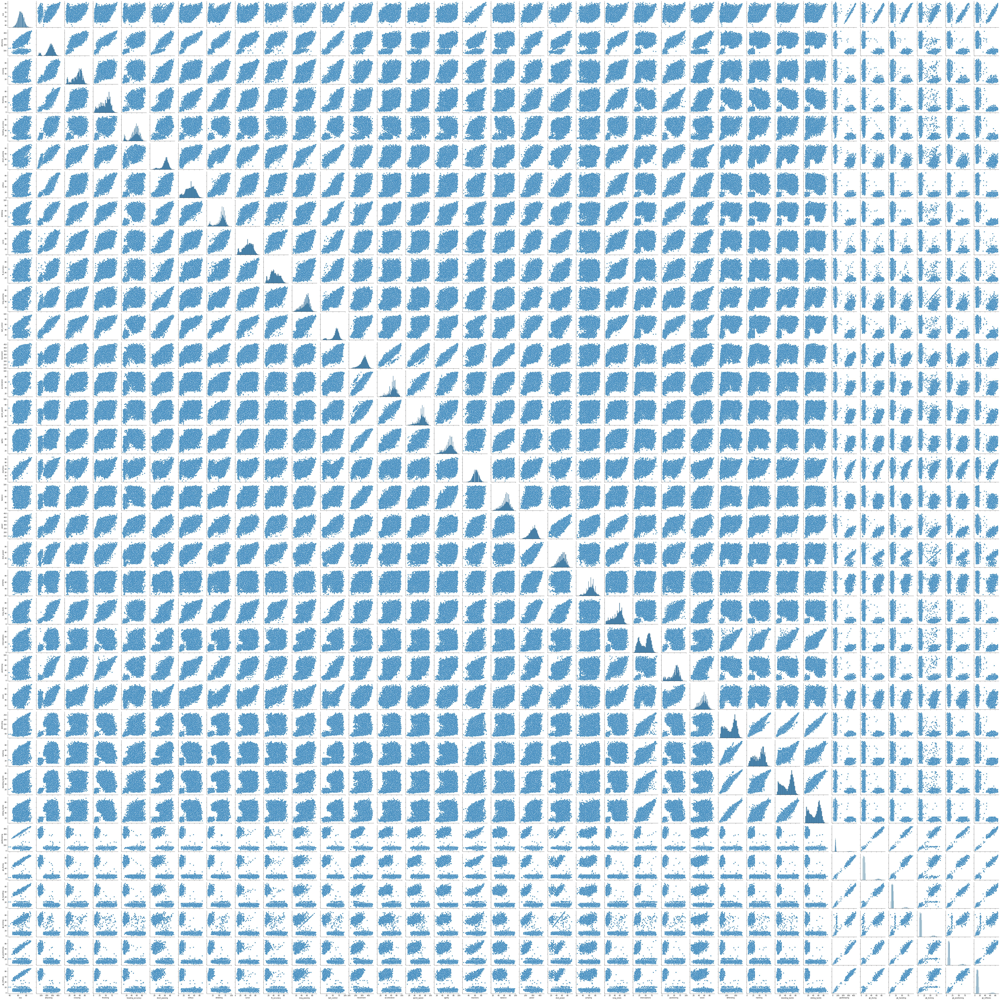

In [14]:
# To have a better (and visual) understanding of how everything is related

sns.pairplot(fifa_project)

In [15]:
# 'bp' stands for Best Position and corresponds with the positions of the players in the field
# There may be more specialized positions depending on the team's strategy, but these are the most common ones

data['bp'].unique() 

array(['LWB', 'CM', 'CAM', 'ST', 'RW', 'CB', 'CF', 'GK', 'CDM', 'RWB',
       'LB', 'LM', 'RM', 'RB', 'LW'], dtype=object)

# As mentioned, we have four general roles, and inside them we have the positions of the players in the field:

 -  Goalkeeper role (GK - Goalkeeper)
 -  Defender role (LWB - Left Wing Back; CB - Center Back; RWB - Right Wing Back; LB - Left Back; RB - Right Back)
 -  Midfielder role (CM - Center Midfielder; CAM - Central Attacking Midfielder; RW - Right Wing; CDM - Central Defensive Midfielder; LM - Left Midfielder; RM - Right Midfielder; LW - Left Wing)
 -  Attacker role (ST - Striker; CF - Center Forward)


 -  So, I divide the new dataset (fifa_project) into four subdatasets corresponding to the four general roles:

In [16]:
goalkeeper = fifa_project[fifa_project['bp'].isin(['GK'])]
defender = fifa_project[fifa_project['bp'].isin(['LWB', 'CB', 'RWB', 'LB', 'RB'])]
midfielder = fifa_project[fifa_project['bp'].isin(['CM', 'CAM', 'RW', 'CDM', 'LM', 'RM', 'LW'])]
attacker = fifa_project[fifa_project['bp'].isin(['ST', 'CF'])]

In [17]:
# Correlation Coefficients and Heatmaps to to find the pairwise correlation of the columns within the new subdatasets

In [18]:
#Goalkeeper role

goalkeeper.corr()

,ova,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,fk_accuracy,long_passing,ball_control,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,long_shots,interceptions,positioning,vision,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes
ova,1.000000,0.435780,0.192855,0.376367,0.188104,0.322149,0.387143,0.350991,0.176279,0.157463,0.312882,0.378361,0.619531,0.474174,0.485144,0.412135,0.866628,0.179119,0.665521,0.500660,0.421322,0.394166,0.434751,0.401674,0.400949,0.344191,0.356363,0.187835,0.169164,0.985811,0.953128,0.938328,0.784211,0.945512,0.948738
attacking,0.435780,1.000000,0.641917,0.730878,0.590743,0.698940,0.751281,0.581244,0.465988,0.378562,0.511226,0.535505,0.539469,0.479672,0.487824,0.342069,0.438903,0.331333,0.529803,0.201854,0.306146,0.673029,0.514102,0.561227,0.213489,0.590423,0.380686,0.519010,0.469151,0.440311,0.400594,0.397400,0.418524,0.410657,0.404050
crossing,0.192855,0.641917,1.000000,0.421439,0.336757,0.234484,0.449308,0.360673,0.477507,0.327995,0.218587,0.268278,0.292425,0.271761,0.273836,0.188795,0.197023,0.214246,0.277465,0.093630,0.142707,0.418929,0.332561,0.360864,0.089561,0.399330,0.240699,0.373089,0.334382,0.197776,0.172209,0.193141,0.223312,0.179343,0.168630
finishing,0.376367,0.730878,0.421439,1.000000,0.415145,0.231100,0.696592,0.511310,0.352487,0.363532,0.230429,0.361061,0.490973,0.462102,0.452635,0.292374,0.394916,0.322651,0.436593,0.108051,0.248525,0.703636,0.514424,0.611499,0.114543,0.529639,0.339691,0.478460,0.428184,0.365268,0.344927,0.337561,0.323937,0.362357,0.347891
heading_accuracy,0.188104,0.590743,0.336757,0.415145,1.000000,0.158643,0.396173,0.348344,0.339715,0.263890,0.164127,0.253260,0.237048,0.232476,0.220302,0.126407,0.199221,0.162623,0.251216,0.042843,0.128543,0.394748,0.283711,0.352516,0.042043,0.437524,0.239753,0.421439,0.399119,0.181027,0.173119,0.174292,0.165502,0.181578,0.167770
short_passing,0.322149,0.698940,0.234484,0.231100,0.158643,1.000000,0.252797,0.344526,0.191133,0.148700,0.671805,0.480037,0.351342,0.284604,0.311461,0.251665,0.305652,0.191151,0.366070,0.222706,0.251589,0.262552,0.250547,0.202676,0.270321,0.275751,0.212485,0.220937,0.175059,0.333434,0.299049,0.287478,0.340059,0.293041,0.309931
volleys,0.387143,0.751281,0.449308,0.696592,0.396173,0.252797,1.000000,0.481543,0.371665,0.344837,0.191201,0.357223,0.474059,0.434099,0.435914,0.287023,0.393592,0.274726,0.459699,0.118870,0.229833,0.718274,0.546094,0.602680,0.090907,0.502825,0.320997,0.431151,0.415639,0.382548,0.352227,0.356818,0.325270,0.380108,0.350942
dribbling,0.350991,0.581244,0.360673,0.511310,0.348344,0.344526,0.481543,1.000000,0.335384,0.302063,0.307820,0.497311,0.437622,0.404491,0.406672,0.294604,0.332051,0.263576,0.390693,0.160829,0.230544,0.526207,0.383505,0.426128,0.188515,0.461058,0.310867,0.410396,0.345786,0.352952,0.337884,0.315451,0.333770,0.331283,0.328742
curve,0.176279,0.465988,0.477507,0.352487,0.339715,0.191133,0.371665,0.335384,1.000000,0.656432,0.213076,0.264532,0.276089,0.234469,0.244721,0.201235,0.170944,0.209839,0.290916,0.145944,0.176853,0.397912,0.274474,0.283166,0.080221,0.331518,0.225004,0.272294,0.263033,0.186961,0.158588,0.158556,0.215256,0.177971,0.154313
fk_accuracy,0.157463,0.378562,0.327995,0.363532,0.263890,0.148700,0.344837,0.302063,0.656432,1.000000,0.183478,0.217618,0.225189,0.188301,0.204641,0.176508,0.167150,0.214998,0.227061,0.090617,0.170586,0.399873,0.200566,0.290511,0.091581,0.303527,0.213770,0.277422,0.245788,0.149147,0.136303,0.122072,0.196145,0.157280,0.149426


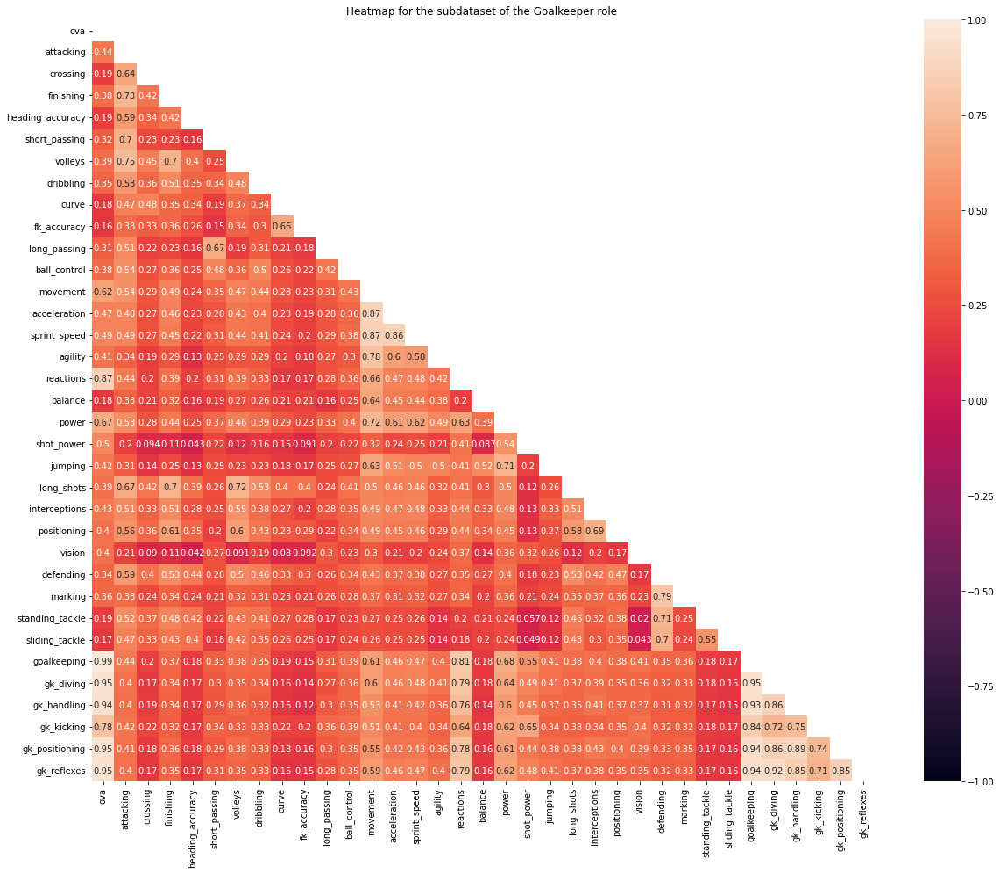

In [19]:
plt.figure(figsize=(20,16))
mask = np.triu(np.ones_like(goalkeeper.corr(), dtype=bool))
sns.heatmap(goalkeeper.corr(), annot=True, mask=mask, vmin=-1, vmax=1)
plt.title('Heatmap for the subdataset of the Goalkeeper role ')
plt.show()

In [20]:
# Defender role

defender.corr()

,ova,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,fk_accuracy,long_passing,ball_control,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,long_shots,interceptions,positioning,vision,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes
ova,1.000000,0.727587,0.423506,0.453648,0.636511,0.788115,0.437237,0.509573,0.460425,0.383266,0.714574,0.740077,0.292473,0.099606,0.160595,0.201664,0.884764,0.057853,0.677896,0.577492,0.288621,0.492522,0.893355,0.400725,0.548496,0.918167,0.881062,0.891992,0.888837,0.104784,0.067518,0.055072,0.091751,0.053071,0.054613
attacking,0.727587,1.000000,0.768326,0.835124,0.341679,0.806091,0.804097,0.735012,0.746509,0.653867,0.745476,0.810055,0.486257,0.289303,0.294999,0.446028,0.685840,0.309053,0.741831,0.709398,0.159340,0.787420,0.586354,0.730474,0.769111,0.586374,0.548624,0.541078,0.585463,0.107437,0.082324,0.043338,0.048769,0.051465,0.050997
crossing,0.423506,0.768326,1.000000,0.593397,-0.134882,0.544346,0.519242,0.794440,0.742810,0.559491,0.473898,0.689996,0.679025,0.550877,0.510784,0.647083,0.409107,0.546112,0.435598,0.417432,0.022766,0.609699,0.255763,0.785635,0.653925,0.247085,0.204079,0.211266,0.297813,0.057616,0.044065,0.035946,0.034105,0.018310,0.028229
finishing,0.453648,0.835124,0.593397,1.000000,0.100773,0.532965,0.700932,0.618931,0.637174,0.599001,0.527991,0.595526,0.431198,0.292446,0.282875,0.416588,0.443559,0.311997,0.630504,0.617597,0.076806,0.751714,0.323714,0.694158,0.667037,0.307881,0.290158,0.271442,0.318736,0.090587,0.066162,0.036751,0.040045,0.055404,0.043439
heading_accuracy,0.636511,0.341679,-0.134882,0.100773,1.000000,0.414501,0.138070,-0.052127,-0.012191,0.062969,0.427300,0.249548,-0.306745,-0.409642,-0.319435,-0.332407,0.548842,-0.420689,0.411516,0.348145,0.272186,0.132412,0.669957,-0.098677,0.126740,0.690412,0.688663,0.695699,0.628182,0.083773,0.052833,0.033995,0.093129,0.046776,0.050628
short_passing,0.788115,0.806091,0.544346,0.532965,0.414501,1.000000,0.490987,0.616874,0.543564,0.457569,0.828773,0.833239,0.376449,0.184446,0.207368,0.333711,0.715445,0.204994,0.628501,0.574578,0.188094,0.572452,0.672695,0.507511,0.655666,0.670036,0.650594,0.635807,0.645021,0.099461,0.064272,0.060242,0.069018,0.048825,0.046554
volleys,0.437237,0.804097,0.519242,0.700932,0.138070,0.490987,1.000000,0.517607,0.636670,0.598176,0.499257,0.527828,0.357986,0.214771,0.203771,0.340371,0.446174,0.264908,0.598819,0.629111,0.084883,0.703604,0.344891,0.580727,0.597037,0.336596,0.316340,0.304351,0.342270,0.080340,0.067690,0.014626,0.050324,0.048550,0.043669
dribbling,0.509573,0.735012,0.794440,0.618931,-0.052127,0.616874,0.517607,1.000000,0.695457,0.510103,0.562353,0.786123,0.688460,0.554247,0.525411,0.646483,0.486271,0.509882,0.492732,0.457362,0.072364,0.618450,0.344942,0.776464,0.707554,0.341242,0.290943,0.307910,0.383593,0.042259,0.030622,0.028626,0.024305,0.008243,0.024564
curve,0.460425,0.746509,0.742810,0.637174,-0.012191,0.543564,0.636670,0.695457,1.000000,0.715840,0.529263,0.644955,0.535680,0.388926,0.360277,0.512578,0.447857,0.418088,0.572604,0.595876,0.069821,0.704700,0.321545,0.707415,0.672672,0.305578,0.275439,0.266434,0.333855,0.054808,0.049431,0.019742,0.023329,0.025530,0.036023
fk_accuracy,0.383266,0.653867,0.559491,0.599001,0.062969,0.457569,0.598176,0.510103,0.715840,1.000000,0.480432,0.505568,0.322941,0.199379,0.175125,0.331953,0.370727,0.264909,0.564138,0.610086,0.040555,0.712249,0.285033,0.545803,0.573007,0.269339,0.261437,0.246254,0.280933,0.083513,0.065451,0.033331,0.053038,0.052017,0.048274


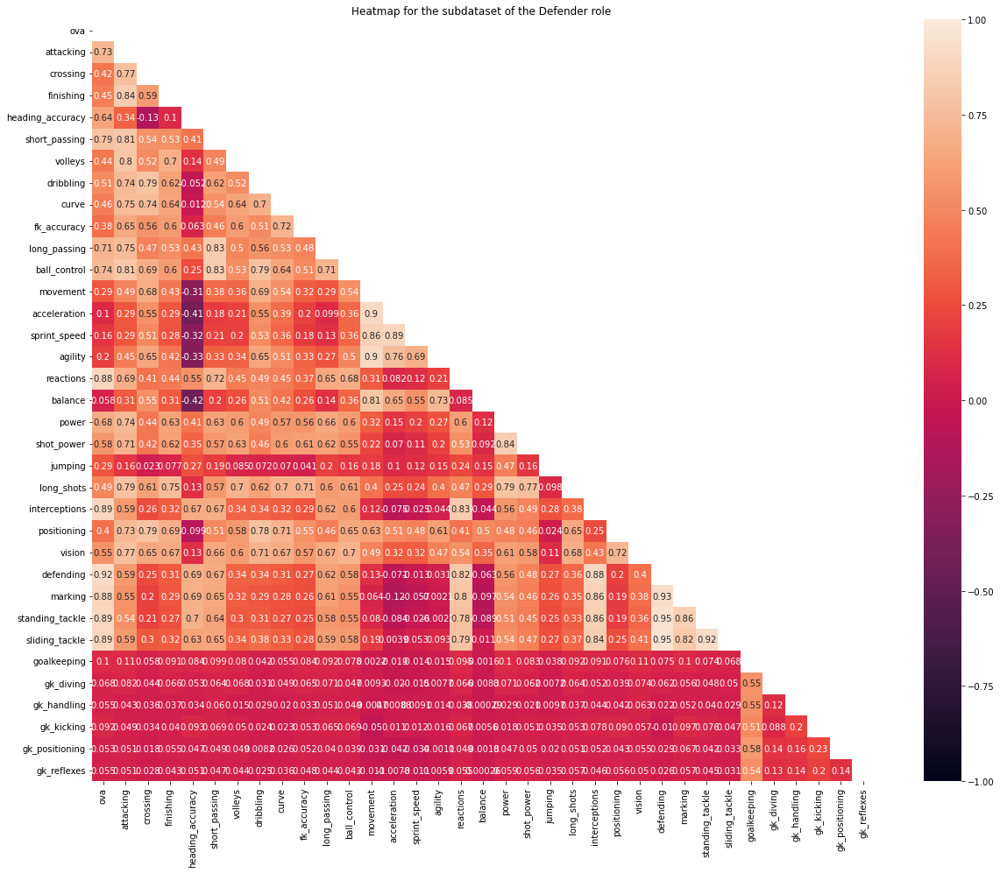

In [21]:
plt.figure(figsize=(20,16))
mask = np.triu(np.ones_like(defender.corr(), dtype=bool))
sns.heatmap(defender.corr(), annot=True, mask=mask, vmin=-1, vmax=1)
plt.title('Heatmap for the subdataset of the Defender role ')
plt.show()

In [22]:
# Midfielder role

midfielder.corr()

,ova,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,fk_accuracy,long_passing,ball_control,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,long_shots,interceptions,positioning,vision,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes
ova,1.000000,0.847024,0.723546,0.625111,0.442943,0.836630,0.621218,0.797233,0.654791,0.567849,0.690194,0.906830,0.421760,0.161076,0.126894,0.313389,0.860460,0.159177,0.720227,0.712427,0.223142,0.739488,0.352228,0.737148,0.821874,0.290239,0.335826,0.277372,0.220692,0.063422,0.030283,0.036128,0.027189,0.039931,0.012726
attacking,0.847024,1.000000,0.823391,0.790363,0.553079,0.734978,0.846674,0.769103,0.755339,0.666864,0.602190,0.816088,0.357950,0.122508,0.109188,0.273797,0.736425,0.116161,0.680009,0.775774,0.194891,0.802622,0.200580,0.789995,0.769711,0.134394,0.176538,0.127694,0.077445,0.052568,0.026937,0.028313,0.008985,0.030495,0.001569
crossing,0.723546,0.823391,1.000000,0.644525,0.223165,0.562903,0.662305,0.711049,0.733012,0.624522,0.465584,0.701961,0.406820,0.217913,0.186001,0.346935,0.576882,0.211446,0.478702,0.625749,0.066945,0.653409,0.077555,0.685004,0.648674,0.020281,0.070651,0.011681,-0.024187,0.045209,0.026382,0.033338,0.023836,0.023026,0.001194
finishing,0.625111,0.790363,0.644525,1.000000,0.167424,0.396894,0.699991,0.721760,0.613395,0.516346,0.244549,0.629144,0.476795,0.340623,0.321795,0.414494,0.484867,0.215578,0.440978,0.593838,0.049373,0.703156,-0.163322,0.765501,0.566059,-0.233563,-0.167956,-0.225269,-0.278292,0.054173,0.033236,0.029052,0.040417,0.019964,0.014556
heading_accuracy,0.442943,0.553079,0.223165,0.167424,1.000000,0.465362,0.259793,0.199207,0.198467,0.203091,0.451896,0.346586,-0.104056,-0.210710,-0.153530,-0.181975,0.472947,-0.255513,0.572744,0.413059,0.372528,0.340575,0.467881,0.277348,0.344887,0.450368,0.432170,0.439345,0.423487,0.044505,0.001093,0.019829,0.025258,0.047241,0.014184
short_passing,0.836630,0.734978,0.562903,0.396894,0.465362,1.000000,0.478742,0.593572,0.563563,0.548013,0.874295,0.801704,0.123925,-0.150746,-0.177129,0.059019,0.784050,0.040030,0.619965,0.602872,0.178653,0.625637,0.526334,0.566036,0.806223,0.487998,0.493321,0.479745,0.430726,0.041213,0.009061,0.026577,0.023630,0.038882,0.002164
volleys,0.621218,0.846674,0.662305,0.699991,0.259793,0.478742,1.000000,0.665006,0.719654,0.625860,0.363743,0.644814,0.370477,0.182762,0.151105,0.336635,0.522983,0.200431,0.474673,0.681791,0.082248,0.698120,-0.024967,0.664078,0.594364,-0.094816,-0.042290,-0.097018,-0.131869,0.026698,0.020264,0.020284,0.020976,0.012913,-0.005235
dribbling,0.797233,0.769103,0.711049,0.721760,0.199207,0.593572,0.665006,1.000000,0.676310,0.518634,0.410550,0.852992,0.581276,0.383222,0.331518,0.500450,0.626327,0.321916,0.458762,0.616687,0.076312,0.659047,-0.017940,0.735509,0.681747,-0.065969,-0.015803,-0.066663,-0.110148,0.020856,0.010305,0.007515,0.007873,0.014577,-0.007073
curve,0.654791,0.755339,0.733012,0.613395,0.198467,0.563563,0.719654,0.676310,1.000000,0.770026,0.481504,0.688853,0.341658,0.131095,0.079442,0.332325,0.550516,0.207597,0.461753,0.650249,0.060041,0.696842,0.081980,0.625289,0.670295,0.021436,0.060971,0.022163,-0.020546,0.035790,0.016894,0.033590,0.031872,0.010928,-0.000285
fk_accuracy,0.567849,0.666864,0.624522,0.516346,0.203091,0.548013,0.625860,0.518634,0.770026,1.000000,0.525124,0.587813,0.183374,-0.023653,-0.060890,0.202068,0.497159,0.131507,0.449249,0.607128,0.049269,0.676369,0.155285,0.521411,0.631618,0.088790,0.115579,0.092092,0.048897,0.057909,0.026319,0.045154,0.052473,0.020442,0.004903


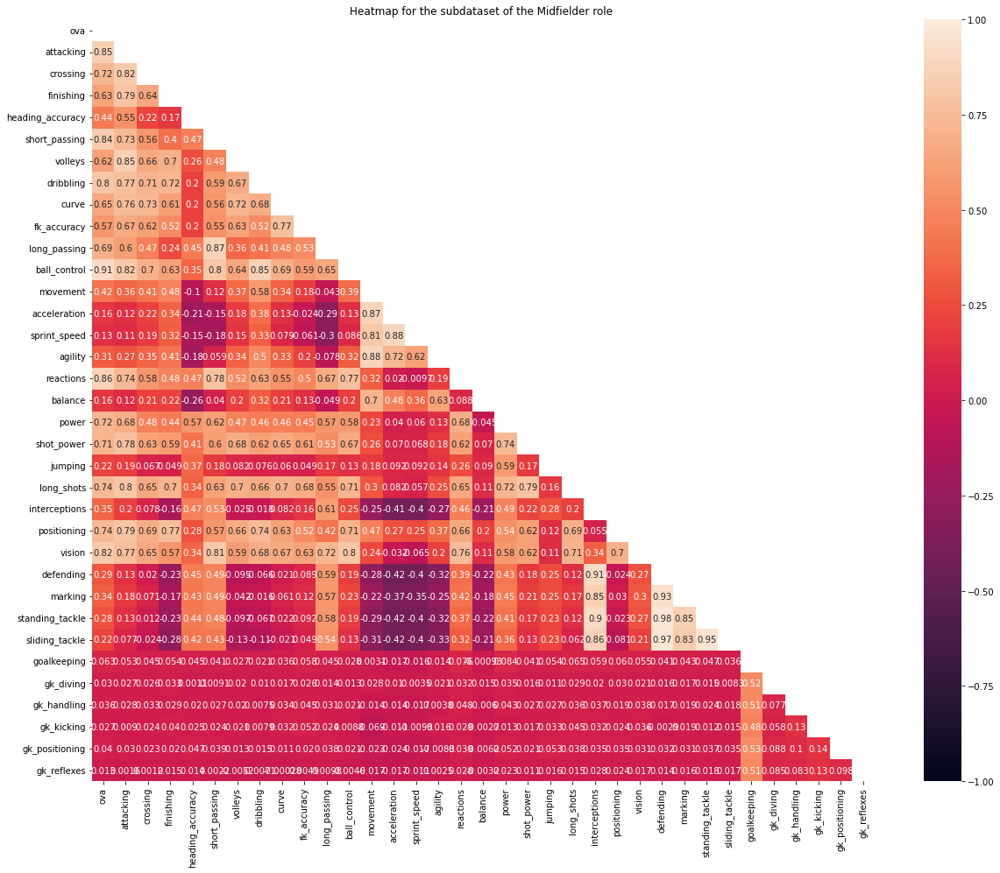

In [23]:
plt.figure(figsize=(20,16))
mask = np.triu(np.ones_like(midfielder.corr(), dtype=bool))
sns.heatmap(midfielder.corr(), annot=True, mask=mask, vmin=-1, vmax=1)
plt.title('Heatmap for the subdataset of the Midfielder role ')
plt.show()

In [24]:
# Attacker role

attacker.corr()

,ova,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,fk_accuracy,long_passing,ball_control,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,long_shots,interceptions,positioning,vision,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes
ova,1.000000,0.917842,0.594531,0.885130,0.722623,0.847472,0.840036,0.822625,0.644124,0.558335,0.604682,0.909995,0.330094,0.144052,0.174964,0.270554,0.891693,0.042167,0.778944,0.858989,0.351405,0.784640,0.390326,0.921158,0.712236,0.359995,0.362648,0.335917,0.242588,0.108399,0.048735,0.076078,0.094577,0.070689,0.081249
attacking,0.917842,1.000000,0.723829,0.841695,0.735926,0.869138,0.887659,0.755171,0.699233,0.602010,0.676374,0.845379,0.288963,0.023636,0.041503,0.211290,0.832113,0.022038,0.755743,0.813033,0.317650,0.773586,0.385897,0.857827,0.765728,0.423513,0.377592,0.376394,0.314953,0.060251,0.051657,0.012026,-0.059457,0.008459,0.022678
crossing,0.594531,0.723829,1.000000,0.429313,0.261951,0.666932,0.537730,0.649719,0.631692,0.589880,0.704698,0.614057,0.340368,0.238096,0.220670,0.354529,0.536231,0.210245,0.432680,0.528870,0.207199,0.537778,0.477856,0.510316,0.665684,0.443562,0.370247,0.434388,0.378225,0.100351,0.022282,0.088474,0.139655,0.077231,0.095510
finishing,0.885130,0.841695,0.429313,1.000000,0.674243,0.699611,0.769635,0.676917,0.551185,0.464855,0.452292,0.781191,0.255811,0.023637,0.035786,0.184888,0.793459,0.035508,0.670209,0.744216,0.281650,0.729857,0.226564,0.848551,0.617524,0.215352,0.224788,0.176589,0.142576,0.052952,0.036677,0.019089,-0.032531,0.021511,0.024403
heading_accuracy,0.722623,0.735926,0.261951,0.674243,1.000000,0.568136,0.643835,0.397083,0.358360,0.313196,0.356658,0.578803,-0.106834,-0.276761,-0.214589,-0.145077,0.647601,-0.284418,0.644146,0.639122,0.313949,0.528945,0.272180,0.704104,0.466882,0.277041,0.270038,0.264990,0.176083,0.080305,0.062654,0.032659,0.002214,0.035408,0.055401
short_passing,0.847472,0.869138,0.666932,0.699611,0.568136,1.000000,0.726659,0.763564,0.630177,0.560052,0.735764,0.830709,0.263979,0.091412,0.097326,0.249244,0.763596,0.076889,0.617051,0.714145,0.258228,0.700095,0.443451,0.769257,0.753284,0.423693,0.401662,0.399103,0.315673,0.088396,0.035441,0.077753,0.116915,0.066437,0.073960
volleys,0.840036,0.887659,0.537730,0.769635,0.643835,0.726659,1.000000,0.666186,0.665146,0.570829,0.535047,0.769870,0.204717,-0.030139,-0.015203,0.168169,0.774592,-0.004758,0.678065,0.777818,0.265737,0.733664,0.357193,0.796201,0.632983,0.328017,0.308947,0.312347,0.225695,0.091651,0.039465,0.043723,0.044909,0.050156,0.057603
dribbling,0.822625,0.755171,0.649719,0.676917,0.397083,0.763564,0.666186,1.000000,0.631459,0.516387,0.605746,0.857483,0.486036,0.351085,0.340325,0.460942,0.701704,0.235575,0.565848,0.669792,0.258755,0.675095,0.314567,0.684250,0.666841,0.303449,0.301034,0.271038,0.229118,0.060793,0.003763,0.060569,0.096836,0.052819,0.054017
curve,0.644124,0.699233,0.631692,0.551185,0.358360,0.630177,0.665146,0.631459,1.000000,0.707073,0.593126,0.651355,0.315936,0.114351,0.084991,0.302438,0.596038,0.157849,0.493408,0.600399,0.179471,0.634622,0.377263,0.578938,0.650982,0.348957,0.322333,0.319053,0.262688,0.058187,0.026437,0.058531,0.032363,0.013301,0.019434
fk_accuracy,0.558335,0.602010,0.589880,0.464855,0.313196,0.560052,0.570829,0.516387,0.707073,1.000000,0.557780,0.555915,0.172255,0.044455,0.014634,0.204802,0.522124,0.108167,0.401066,0.540689,0.130243,0.606859,0.390652,0.508060,0.567072,0.326887,0.281212,0.322190,0.269938,0.111228,0.036646,0.093429,0.137222,0.053465,0.091546


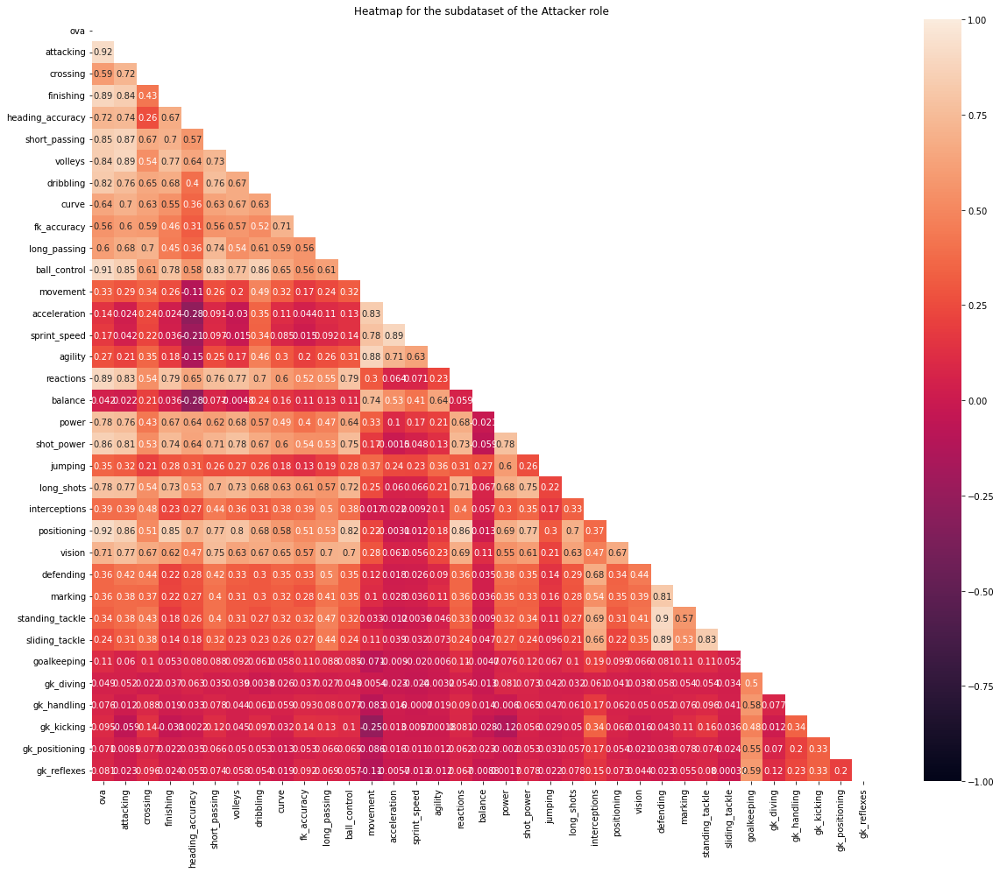

In [25]:
plt.figure(figsize=(20,16))
mask = np.triu(np.ones_like(attacker.corr(), dtype=bool))
sns.heatmap(attacker.corr(), annot=True, mask=mask, vmin=-1, vmax=1)
plt.title('Heatmap for the subdataset of the Attacker role ')
plt.show()

# From  above, we can extract some conclusions:

 -  The player skills that are primarily drivers of the OVA for the Goalkeepers are goalkeeping, gk diving, gk handling, gk positioning, gk reflexes, and reactions.


 -  The player skills that are main drivers of the OVA for the Defenders are defending, marking, standing tackle, sliding tackle, interceptions, and reactions. 


 -  The player skills that are main drivers of the OVA for the Midfielders are reactions, ball control, and attacking. 


 -  The player skills that are main drivers of the OVA for the Attackers are positioning, shot power, reactions, ball control, short passing, finishing, and attacking. 


 -  As we can see, reacting, or acting in response to something (responding in a particular way), usually fast, is the player skills that is main driver of the OVA common for all four general roles in the field.


 -  (these conclusions have derivered by observing the players' skills with correlation with OVA equal or greater to 0.85). 

In [26]:
# I continue towards the application of the Linear Regression Model by applying some scaling to fifa_project dataset, that includes all four general roles

def boxcox_transform(fifa_project):
    numeric_cols = fifa_project.select_dtypes(np.number).columns
    _ci = {column: None for column in numeric_cols}
    for column in numeric_cols:
        fifa_project[column] = np.where(fifa_project[column]<=0, np.NAN, fifa_project[column]) 
        fifa_project[column] = fifa_project[column].fillna(fifa_project[column].mean())
        transformed_data, ci = stats.boxcox(fifa_project[column])
        fifa_project[column] = transformed_data
        _ci[column] = [ci] 
    return fifa_project, _ci

In [27]:
fifa_project, _ci = boxcox_transform(fifa_project)
fifa_project

,ova,bp,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,fk_accuracy,long_passing,ball_control,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,long_shots,interceptions,positioning,vision,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes
0,58.848889,LWB,56934.043922,519.861971,92.405244,623.109242,14332.041639,72.529066,3509.565771,126.785063,34.968870,799.195128,14162.192412,712496.156462,3459.596157,4688.176875,1953.780186,209.911868,1600.661728,89046.968991,590.769067,947.972059,201.671066,61.853209,433.918776,345.640080,214.493502,87.313895,80.681960,57.524846,1.028941,1.190123,0.956792,1.209168,1.123424,1.158236
1,60.507424,CM,66139.801903,446.511318,124.781721,659.693264,16939.287403,86.245844,3122.648141,160.649222,44.262983,839.115074,14162.192412,518895.289657,2297.446850,2025.133541,1630.926755,193.813258,1784.436837,77245.658833,603.532778,631.872935,213.590543,63.622612,535.695642,401.805764,157.118281,87.313895,48.695660,33.863223,1.028941,1.110789,1.163142,1.186805,1.140941,1.143180
2,60.507424,CAM,66139.801903,574.633760,124.781721,334.145282,17491.941822,95.941201,4133.894547,173.060137,43.304106,799.195128,17835.988029,478077.050523,1659.915979,1394.141014,2125.862520,170.278947,1928.462466,58781.335699,565.546685,716.546451,205.625599,35.102392,500.904041,410.053803,100.952649,41.083240,37.831809,25.521368,1.026811,1.110789,1.010981,1.186805,1.199238,1.047854
3,58.018831,ST,40306.154688,312.146481,139.135727,641.293042,19213.448114,54.979048,3029.567954,91.202854,27.800399,702.942079,17280.310143,134343.664473,2564.666312,3209.860895,1767.457716,155.019643,1456.855058,41107.783595,457.197100,879.664198,166.953300,62.738093,535.695642,266.388996,76.064403,39.799323,46.270350,38.897342,1.032801,0.958048,1.241419,1.344165,1.232703,1.235501
4,68.770363,CAM,78631.537298,519.861971,136.725012,535.474429,25658.655081,101.512933,4811.233903,163.118757,39.913982,1095.221455,25335.993051,707460.394125,2751.413149,2581.311194,2619.350974,234.641503,1928.462466,64496.470514,504.297365,372.553067,209.598818,62.738093,607.799687,576.805949,186.309641,84.617315,65.823546,46.997605,1.023647,1.012422,1.176342,1.017973,1.168884,1.047854
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17120,54.693131,CB,22256.113947,159.053626,35.677771,754.905193,5203.354520,30.045042,1228.717903,41.413121,20.803175,238.750723,7912.383908,296840.148244,1965.099151,2483.618707,909.758320,129.201530,640.185501,56656.210284,296.424152,997.572187,61.701030,52.093756,88.165202,100.944950,204.051339,75.224381,83.172039,55.105232,1.019538,1.149922,1.083356,1.091714,0.952432,1.047854
17121,48.013556,CAM,35504.899041,276.967760,76.882523,469.376742,11106.975306,49.641978,2101.468012,74.515304,29.881985,647.658808,7237.102439,490114.492657,2751.413149,3321.730109,1156.269859,151.260901,1600.661728,53340.180320,326.498380,805.768420,126.829053,44.962799,350.198271,249.030772,135.252981,39.799323,47.482260,46.997605,1.029323,1.165228,1.198141,1.059338,1.155914,1.143180
17122,48.013556,RB,27333.290624,321.171883,57.695561,518.612227,3947.341106,40.413133,1737.266577,76.685122,21.356104,263.244600,5148.249830,531529.063499,3248.561947,3100.031261,1244.835231,170.278947,1600.661728,38997.180027,125.398945,783.040593,89.607674,49.423198,291.809608,194.972823,167.539149,67.233406,62.132901,45.367580,1.020306,1.085077,1.051604,0.962885,1.155914,1.079304
17123,53.026877,RB,28620.100370,386.851042,41.502548,501.974378,9478.877251,26.215990,1951.486232,76.685122,27.800399,576.882541,8263.475286,722631.305215,3902.659745,4162.301586,2305.029900,158.801086,2027.417221,49340.525163,326.498380,1048.258799,76.894679,52.093756,264.095460,270.394761,185.266423,69.890544,71.996692,51.059909,1.026811,1.200410,1.176342,1.091714,1.00598

In [28]:
# For now we will continue without removing the outliers

In [29]:
# Encoding the categorical column: 'bp'

fifa_project = pd.get_dummies(fifa_project, drop_first=True) 
fifa_project

,ova,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,fk_accuracy,long_passing,ball_control,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,long_shots,interceptions,positioning,vision,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,bp_CB,bp_CDM,bp_CF,bp_CM,bp_GK,bp_LB,bp_LM,bp_LW,bp_LWB,bp_RB,bp_RM,bp_RW,bp_RWB,bp_ST
0,58.848889,56934.043922,519.861971,92.405244,623.109242,14332.041639,72.529066,3509.565771,126.785063,34.968870,799.195128,14162.192412,712496.156462,3459.596157,4688.176875,1953.780186,209.911868,1600.661728,89046.968991,590.769067,947.972059,201.671066,61.853209,433.918776,345.640080,214.493502,87.313895,80.681960,57.524846,1.028941,1.190123,0.956792,1.209168,1.123424,1.158236,0,0,0,0,0,0,0,0,1,0,0,0,0,0
1,60.507424,66139.801903,446.511318,124.781721,659.693264,16939.287403,86.245844,3122.648141,160.649222,44.262983,839.115074,14162.192412,518895.289657,2297.446850,2025.133541,1630.926755,193.813258,1784.436837,77245.658833,603.532778,631.872935,213.590543,63.622612,535.695642,401.805764,157.118281,87.313895,48.695660,33.863223,1.028941,1.110789,1.163142,1.186805,1.140941,1.143180,0,0,0,1,0,0,0,0,0,0,0,0,0,0
2,60.507424,66139.801903,574.633760,124.781721,334.145282,17491.941822,95.941201,4133.894547,173.060137,43.304106,799.195128,17835.988029,478077.050523,1659.915979,1394.141014,2125.862520,170.278947,1928.462466,58781.335699,565.546685,716.546451,205.625599,35.102392,500.904041,410.053803,100.952649,41.083240,37.831809,25.521368,1.026811,1.110789,1.010981,1.186805,1.199238,1.047854,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,58.018831,40306.154688,312.146481,139.135727,641.293042,19213.448114,54.979048,3029.567954,91.202854,27.800399,702.942079,17280.310143,134343.664473,2564.666312,3209.860895,1767.457716,155.019643,1456.855058,41107.783595,457.197100,879.664198,166.953300,62.738093,535.695642,266.388996,76.064403,39.799323,46.270350,38.897342,1.032801,0.958048,1.241419,1.344165,1.232703,1.235501,0,0,0,0,0,0,0,0,0,0,0,0,0,1
4,68.770363,78631.537298,519.861971,136.725012,535.474429,25658.655081,101.512933,4811.233903,163.118757,39.913982,1095.221455,25335.993051,707460.394125,2751.413149,2581.311194,2619.350974,234.641503,1928.462466,64496.470514,504.297365,372.553067,209.598818,62.738093,607.799687,576.805949,186.309641,84.617315,65.823546,46.997605,1.023647,1.012422,1.176342,1.017973,1.168884,1.047854,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17120,54.693131,22256.113947,159.053626,35.677771,754.905193,5203.354520,30.045042,1228.717903,41.413121,20.803175,238.750723,7912.383908,296840.148244,1965.099151,2483.618707,909.758320,129.201530,640.185501,56656.210284,296.424152,997.572187,61.701030,52.093756,88.165202,100.944950,204.051339,75.224381,83.172039,55.105232,1.019538,1.149922,1.083356,1.091714,0.952432,1.047854,1,0,0,0,0,0,0,0,0,0,0,0,0,0
17121,48.013556,35504.899041,276.967760,76.882523,469.376742,11106.975306,49.641978,2101.468012,74.515304,29.881985,647.658808,7237.102439,490114.492657,2751.413149,3321.730109,1156.269859,151.260901,1600.661728,53340.180320,326.498380,805.768420,126.829053,44.962799,350.198271,249.030772,135.252981,39.799323,47.482260,46.997605,1.029323,1.165228,1.198141,1.059338,1.155914,1.143180,0,0,0,0,0,0,0,0,0,0,0,0,0,0
17122,48.013556,27333.290624,321.171883,57.695561,518.612227,3947.341106,40.413133,1737.266577,76.685122,21.356104,263.244600,5148.249830,531529.063499,3248.561947,3100.031261,1244.835231,170.278947,1600.661728,38997.180027,125.398945,783.040593,89.607674,49.423198,291.809608,194.972823,167.539149,67.233406,62.132901,45.367580,1.020306,1.085077,1.051604,0.962885,1.155914,1.079304,0,0,0,0,0,0,0,0,0,1,0,0,0,0
17123,53.026877,28620.100370,386.851042,41.5

In [30]:
# Splitting fifa_project dataset data

# X-y split

X = fifa_project.drop('ova', axis=1)
y = fifa_project['ova']

# Train-test split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [31]:
# Starting the model

model = LinearRegression()


# Training the model

model.fit(X_train, y_train)

LinearRegression()

In [32]:
# Getting predictions

predictions = model.predict(X_test)

In [33]:
# Model Validation 

r2_score = r2_score(y_test, predictions)
mse = mean_squared_error(y_test, predictions, squared=True)
rmse = mean_squared_error(y_test, predictions, squared=False) 
mae = mean_absolute_error(y_test, predictions)


print("R2_score:", r2_score)
print("MSE:", mse)
print("RMSE:", rmse)
print("MAE:", mae)

R2_score: 0.8810301835187789
MSE: 3.848951943431462
RMSE: 1.9618745993134887
MAE: 1.485596395261517


In [34]:
results = pd.DataFrame()
results['true'] = inv_boxcox(y_test, _ci['ova'])
results['pred'] = predictions
results['resid'] = results.apply(lambda x: abs(x['true'] - x['pred']), axis=1)
results

,true,pred,resid
15195,59.0,47.484524,11.515476
14193,65.0,55.999362,9.000638
16722,62.0,53.260468,8.739532
8037,68.0,52.521155,15.478845
6350,76.0,65.674917,10.325083
...,...,...,...
7576,61.0,53.922408,7.077592
2030,77.0,64.136004,12.863996
11632,65.0,52.882032,12.117968
39,75.0,64.456900,10.543100


In [35]:
results.describe()

,true,pred,resid
count,5138.000000,5138.000000,5138.000000
mean,67.079992,57.219327,9.864691
std,6.846152,5.400339,2.556773
min,47.000000,40.229290,0.030261
25%,63.000000,53.560130,8.326044
50%,67.000000,57.084242,9.898925
75%,72.000000,60.786542,11.519553
max,90.000000,79.197306,22.533779


<AxesSubplot:xlabel='true', ylabel='pred'>

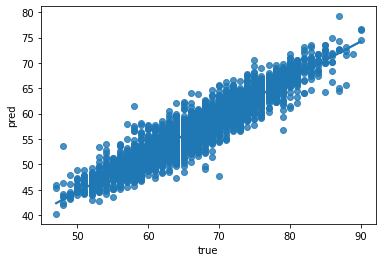

In [36]:
sns.regplot(results['true'], results['pred'])

# Final conclusions:

 -  Removing outliers appears not to have been necessary to obtain acceptable results.


 -  Despite having seen previously that there are player skills that have a greater or lesser weight in what will be the player's OVA, depending on the role in the field we are talking about, we can conclude that the selection of skills that I have made, as a whole, has been correct and that all of them have some importance in what will be the player's OVA, as shown by the results of the linear regression model used.